# 🧠 Logistic Regression with Gradient Descent
This notebook implements logistic regression using gradient descent on the Breast Cancer dataset.
We'll reduce the dimensionality using PCA for visualization, and explain the math step-by-step.

In [50]:
# 📦 Import libraries
import numpy as np
import matplotlib.pyplot as plt
import chinese_matplotlib
from sklearn.datasets import load_breast_cancer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

[Info] 成功设置Matplotlib中文字体：Hiragino Sans GB


## 🔢 Step 1: Load and preprocess data

In [51]:
# Load dataset
data = load_breast_cancer()
X = data.data  # features (30-dimensional)
y = data.target.reshape(-1, 1)  # labels (0 or 1)

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reduce to 2D for visualization
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(X_scaled)

## ⚙️ Step 2: Initialize model parameters
We initialize weights to 0 and set learning rate and training iterations.

In [52]:
np.random.seed(42)
m, n = X_reduced.shape
weights = np.zeros((n, 1))  # shape: (2, 1)
bias = 0
learning_rate = 0.1
epochs = 1000
losses = []

## 📐 Step 3: Define the sigmoid function
Sigmoid squashes real-valued input to (0,1):
$$
\sigma(z) = \frac{1}{1 + e^{-z}}
$$

### 📚 What is the Sigmoid Function?
The sigmoid function maps any real number to the range (0, 1). It is defined as:
$$
\sigma(z) = \frac{1}{1 + e^{-z}}
$$
- When \( z \) is large and positive, \( \sigma(z) \approx 1 \)
- When \( z \) is large and negative, \( \sigma(z) \approx 0 \)

This is why sigmoid is ideal for binary classification: it outputs probabilities.

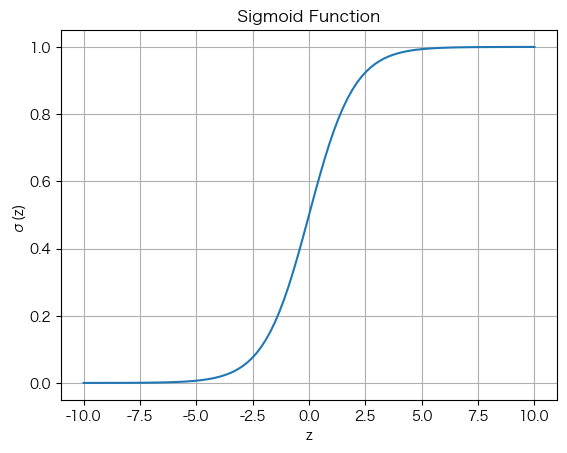

In [53]:
# Define sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# 📈 Plotting sigmoid function
z = np.linspace(-10, 10, 100)
sig = sigmoid(z)
plt.plot(z, sig)
plt.title("Sigmoid Function")
plt.xlabel("z")
plt.ylabel("σ(z)")
plt.grid(True)
plt.show()

### 🔍 Understanding the Gradients
We update parameters using gradient descent:

- Weight gradients:
$$
\frac{\partial L}{\partial w_j} = \frac{1}{m} \sum_{i=1}^m (\hat{y}^{(i)} - y^{(i)}) x_j^{(i)}
$$

- Bias gradient:
$$
\frac{\partial L}{\partial b} = \frac{1}{m} \sum_{i=1}^m (\hat{y}^{(i)} - y^{(i)})
$$

We use these gradients to perform parameter updates iteratively.

### 📉 Understanding the Loss Curve
This curve shows how the binary cross-entropy loss decreases over time.

- A steadily decreasing curve indicates that our model is learning.
- If the curve flattens or increases, we may need to adjust the learning rate.

The binary cross-entropy loss penalizes incorrect predictions more heavily when they are confident but wrong.

### 🧭 What is a Decision Boundary?
The decision boundary is where our model is unsure whether to predict class 0 or 1.
It is defined by:
$$
\sigma(w^T x + b) = 0.5 \Rightarrow w^T x + b = 0
$$
This equation describes a line (or hyperplane) separating the two classes in feature space.

## 🔁 Step 4: Training with gradient descent
We minimize binary cross-entropy loss:
$$
L = -\frac{1}{m} \sum y \log(\hat{y}) + (1 - y) \log(1 - \hat{y})
$$

In [54]:
for epoch in range(epochs):
    z = np.dot(X_reduced, weights) + bias
    y_pred = sigmoid(z)

    # Compute loss
    loss = -np.mean(y * np.log(y_pred + 1e-8) + (1 - y) * np.log(1 - y_pred + 1e-8))
    losses.append(loss)

    # Compute gradients
    dw = np.dot(X_reduced.T, (y_pred - y)) / m
    db = np.mean(y_pred - y)

    # Update parameters
    weights -= learning_rate * dw
    bias -= learning_rate * db

## 📉 Step 5: Plot loss over epochs

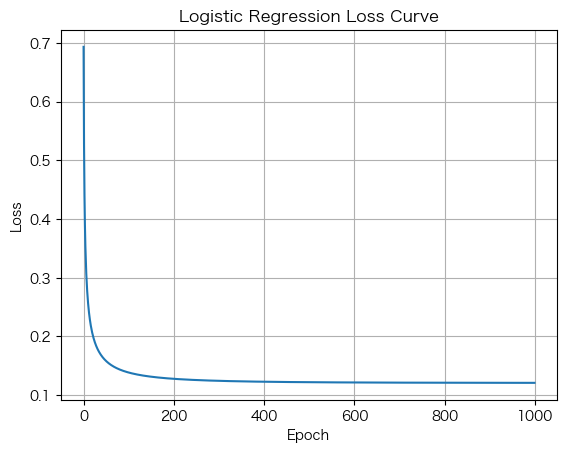

In [55]:
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Logistic Regression Loss Curve")
plt.grid(True)
plt.show()

## 🧭 Step 6: Visualize decision boundary in PCA space

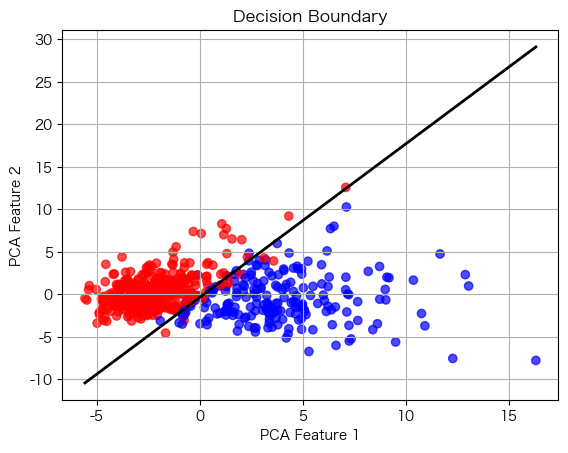

In [56]:
x1 = np.linspace(X_reduced[:, 0].min(), X_reduced[:, 0].max(), 100)
x2 = -(weights[0] * x1 + bias) / weights[1]

plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y.ravel(), cmap='bwr', alpha=0.7)
plt.plot(x1, x2, color='black', linewidth=2)
plt.xlabel("PCA Feature 1")
plt.ylabel("PCA Feature 2")
plt.title("Decision Boundary")
plt.grid(True)
plt.show()

## 🎯 Step 7: Define prediction and evaluate accuracy
We compute predictions using a threshold of 0.5, and calculate accuracy.

In [57]:
def predict(X, weights, bias):
    z = np.dot(X, weights) + bias
    return (sigmoid(z) >= 0.5).astype(int)

y_pred_class = predict(X_reduced, weights, bias)
accuracy = np.mean(y_pred_class == y)
print(f"Accuracy (our model): {accuracy:.4f}")

Accuracy (our model): 0.9561


## 🤖 Step 8: Compare with sklearn's LogisticRegression

In [58]:
from sklearn.linear_model import LogisticRegression

clf = LogisticRegression()
clf.fit(X_reduced, y.ravel())
accuracy_sklearn = clf.score(X_reduced, y)
print(f"Accuracy (sklearn): {accuracy_sklearn:.4f}")

Accuracy (sklearn): 0.9561


## 🤖 Step 9: Compare with Keras (TensorFlow) Logistic Regression

In [59]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import SGD

# Build model
model = Sequential([
    Dense(1, input_dim=2, activation='sigmoid')
])

model.compile(optimizer=SGD(learning_rate=0.1), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_reduced, y, epochs=100, verbose=0)

loss, accuracy_keras = model.evaluate(X_reduced, y, verbose=0)
print(f"Accuracy (keras): {accuracy_keras:.4f}")

/opt/anaconda3/envs/my_env/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Accuracy (keras): 0.9543


## 🎨 Step 10: Visualize Correct vs Incorrect Predictions
### ✅🟥 Visualizing Prediction Outcomes 可视化预测结果
We color predictions as:
- ✅ Correct predictions (green / 绿色)
- ❌ Incorrect predictions (red / 红色)

绿色点表示模型预测正确，红色表示预测错误。

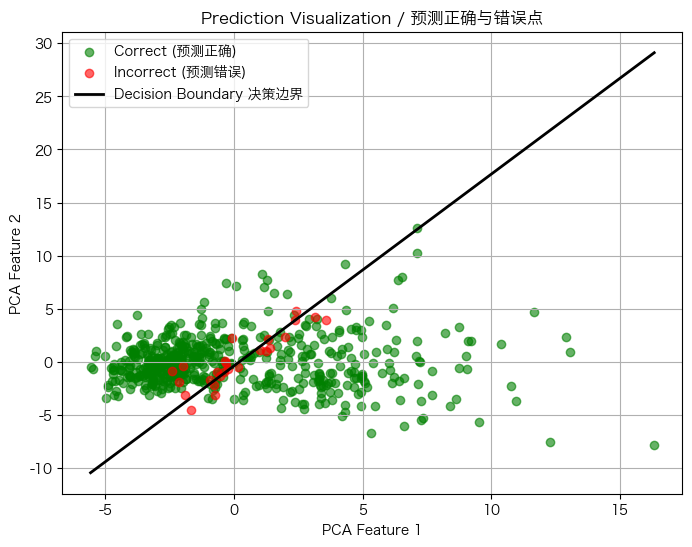

In [60]:
# Predict and compare
y_pred_class = predict(X_reduced, weights, bias)
correct = (y_pred_class == y).ravel()

# Plot
plt.figure(figsize=(8, 6))
plt.scatter(X_reduced[correct, 0], X_reduced[correct, 1], c='green', label='Correct (预测正确)', alpha=0.6)
plt.scatter(X_reduced[~correct, 0], X_reduced[~correct, 1], c='red', label='Incorrect (预测错误)', alpha=0.6)

# Decision boundary
x1 = np.linspace(X_reduced[:, 0].min(), X_reduced[:, 0].max(), 100)
x2 = -(weights[0] * x1 + bias) / weights[1]
plt.plot(x1, x2, color='black', linewidth=2, label='Decision Boundary 决策边界')

plt.xlabel("PCA Feature 1")
plt.ylabel("PCA Feature 2")
plt.title("Prediction Visualization / 预测正确与错误点")
plt.legend()
plt.grid(True)
plt.show()

## 🎞️ Step 11: Animate the Training Process / 动画展示训练过程
We'll show how the decision boundary evolves over training epochs.
通过动画可视化每一次训练更新后模型的决策边界变化。

Animation size has reached 20973969 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


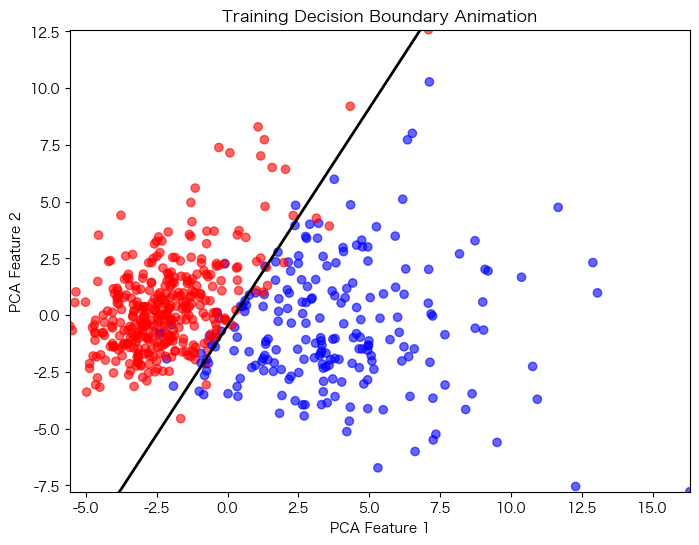

In [61]:
import matplotlib.animation as animation
from IPython.display import HTML

# 🧠 Re-train and record weights per step
weights_list, bias_list = [], []
weights = np.zeros((n, 1))
bias = 0
for epoch in range(200):  # use fewer epochs for animation
    z = np.dot(X_reduced, weights) + bias
    y_pred = sigmoid(z)
    dw = np.dot(X_reduced.T, (y_pred - y)) / m
    db = np.mean(y_pred - y)
    weights -= learning_rate * dw
    bias -= learning_rate * db
    weights_list.append(weights.copy())
    bias_list.append(bias)

# 🎥 Create animation
fig, ax = plt.subplots(figsize=(8,6))
scatter = ax.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y.ravel(), cmap='bwr', alpha=0.6)
line, = ax.plot([], [], 'k-', linewidth=2)

def init():
    ax.set_xlim(X_reduced[:, 0].min(), X_reduced[:, 0].max())
    ax.set_ylim(X_reduced[:, 1].min(), X_reduced[:, 1].max())
    ax.set_xlabel("PCA Feature 1")
    ax.set_ylabel("PCA Feature 2")
    ax.set_title("Training Decision Boundary Animation")
    return line,

def update(frame):
    w = weights_list[frame]
    b = bias_list[frame]
    x_vals = np.linspace(X_reduced[:, 0].min(), X_reduced[:, 0].max(), 100)
    y_vals = -(w[0] * x_vals + b) / w[1]
    line.set_data(x_vals, y_vals)
    return line,

ani = animation.FuncAnimation(fig, update, frames=len(weights_list), init_func=init, blit=True, interval=50)
HTML(ani.to_jshtml())